In [4]:
!pip install -q imageio

import numpy as np
import pandas as pd
from scipy import stats
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from IPython.display import display, Image
import imageio
import time

import forest_model as fm

# исходное
w = 200
h = 200
eta = 0.8
Pf = 2e-5
Pg = 0.02
seed = 1097
num_iterations = 500

cmap = ListedColormap(['#49423D', 'darkgreen', 'orange'])

In [5]:
# Функции отрисовки

def draw_simulation_graph(result_data, f_value, neighborhood, cmap):
    plt.figure(figsize=(12, 6))

    stats_data = result_data['stats']

    plt.plot(stats_data['fire'],  color=cmap.colors[2], label=f'Горящие деревья $N_{{fire}}$')
    plt.plot(stats_data['tree'],  color=cmap.colors[1], label=f'Деревья $N_{{tree}}$')
    plt.plot(stats_data['empty'], color=cmap.colors[0], label=f'Пустые клетки $N_{{empty}}$')

    plt.title(f"Динамика пожара | f={f_value}, Окрестность='{neighborhood.value}'", fontsize=14)
    plt.xlabel("Итерация (t с.)", fontsize=12)
    plt.ylabel("Количество (N клеток)", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12, loc='upper right')

    plot_filename = f"plot_f{f_value}_hood{neighborhood.name}.png"
    plt.savefig(plot_filename, dpi=300, bbox_inches='tight')

    plt.show()


def create_simulation_gif(result_data, f_value, neighborhood, cmap, w, h, num_iterations, frame_step=5):

    gif_filename = f"forest_fire_f{f_value}_hood{neighborhood.name}.gif"
    print(f"Генерируем GIF {gif_filename}...")

    frames_for_gif = []
    history_subset = result_data['history'][::frame_step]

    for i, frame_data in enumerate(history_subset):
        fig, ax = plt.subplots(figsize=(8, 8))

        iteration_num = i * frame_step
        ax.set_title(f"Окрестность: '{neighborhood.value}', f={f_value}\nИтерация: {iteration_num}/{num_iterations}", fontsize=14)

        ax.imshow(frame_data, cmap=cmap, interpolation='nearest')

        tick_step = 20
        ax.set_xticks(np.arange(-.5, w, tick_step), minor=False)
        ax.set_yticks(np.arange(-.5, h, tick_step), minor=False)
        ax.grid(which='major', color='white', linestyle='--', linewidth=0.5, alpha=0.5)
        ax.set_xticklabels(np.arange(0, w + 1, tick_step))
        ax.set_yticklabels(np.arange(0, h + 1, tick_step))

        # конвертируем во фрейм
        fig.canvas.draw()
        image = np.asarray(fig.canvas.buffer_rgba())
        frames_for_gif.append(image)
        plt.close(fig)

    imageio.mimsave(gif_filename, frames_for_gif, fps=10)
    print(f"Анимация сохранена: {gif_filename}")

    display(Image(open(gif_filename, 'rb').read()))

In [9]:
# ЭКСПЕРИМЕНТ 1
F_VALUE = 1
NEIGHBORHOOD = fm.NeighborhoodType.NEUMAN

print(f"Симулируем при f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

result_f1_neuman = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Симулируем при f=1, окрестность='+'...
Готово за 58.81 с.


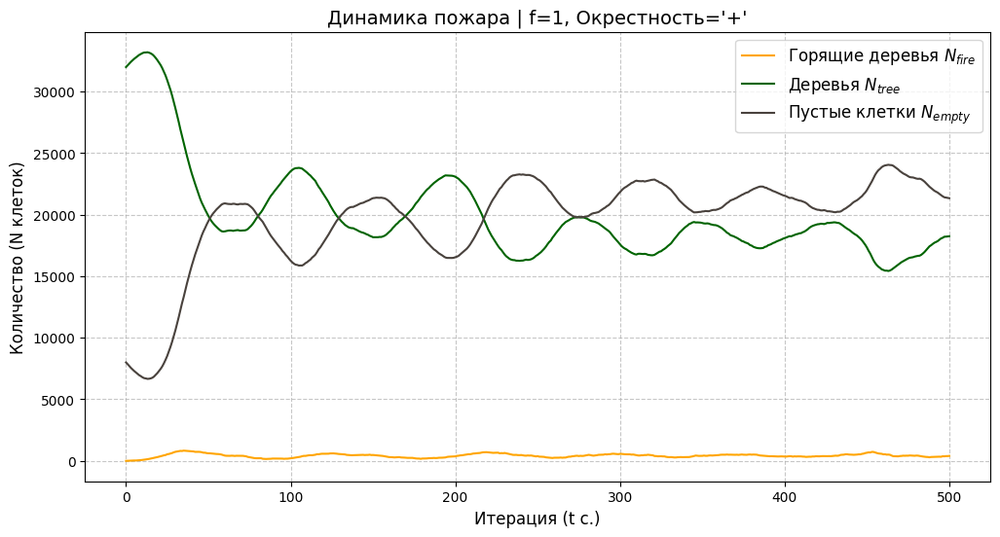

In [ ]:
# График эксперимент 1
draw_simulation_graph(result_f1_neuman, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f1_hoodNEUMAN.gif...
Анимация сохранена: forest_fire_f1_hoodNEUMAN.gif


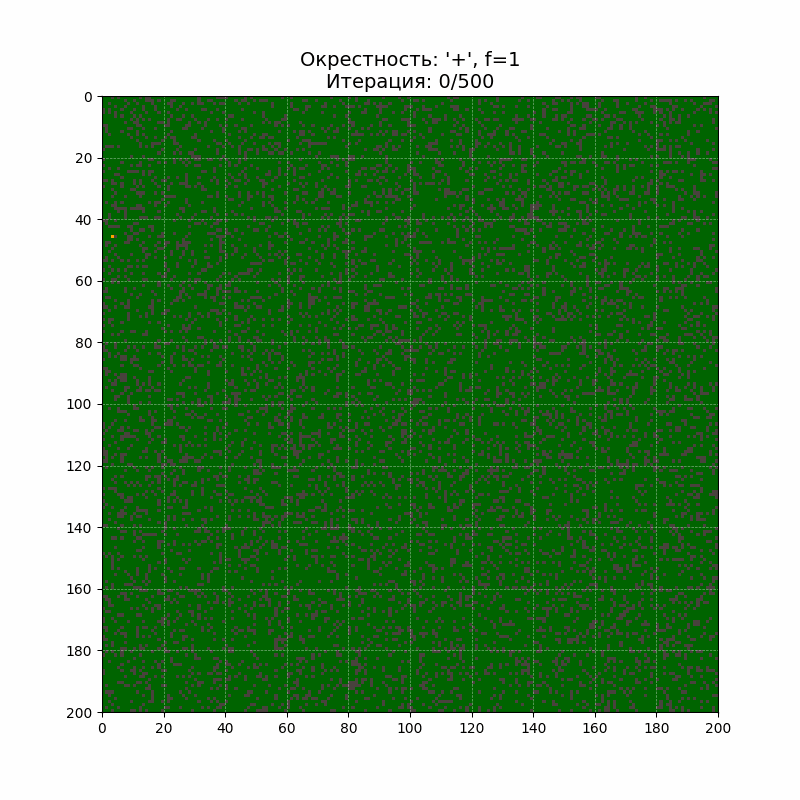

In [ ]:
# GIF эксперимент 1
create_simulation_gif(result_f1_neuman, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [10]:
# ЭКСПЕРИМЕНТ 2
F_VALUE = 1
NEIGHBORHOOD = fm.NeighborhoodType.MOORE

print(f"Запускаем симуляцию: f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

result_f1_moore = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Запускаем симуляцию: f=1, окрестность='x'...
Готово за 65.55 с.


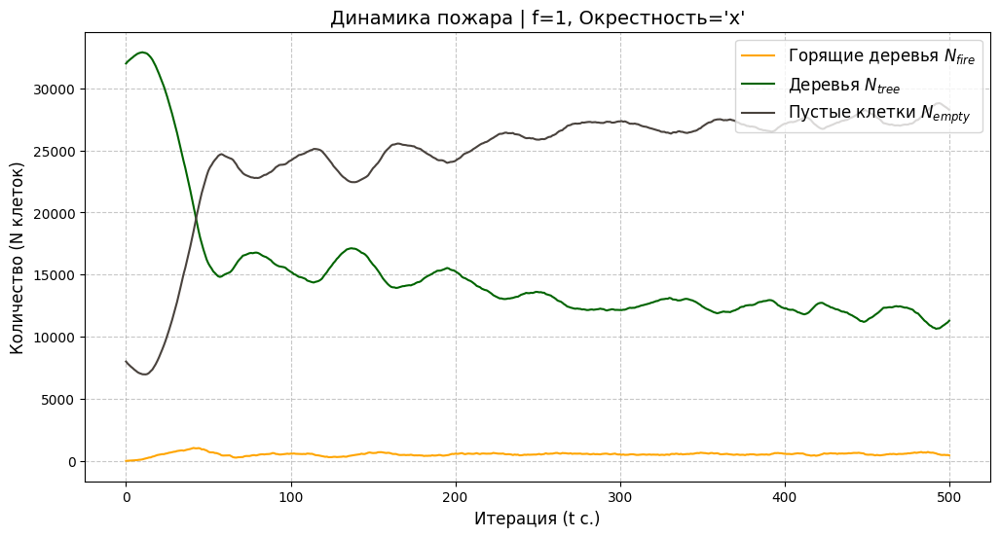

In [ ]:
# ГРАФИК Э 2
draw_simulation_graph(result_f1_moore, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f1_hoodMOORE.gif...
Анимация сохранена: forest_fire_f1_hoodMOORE.gif


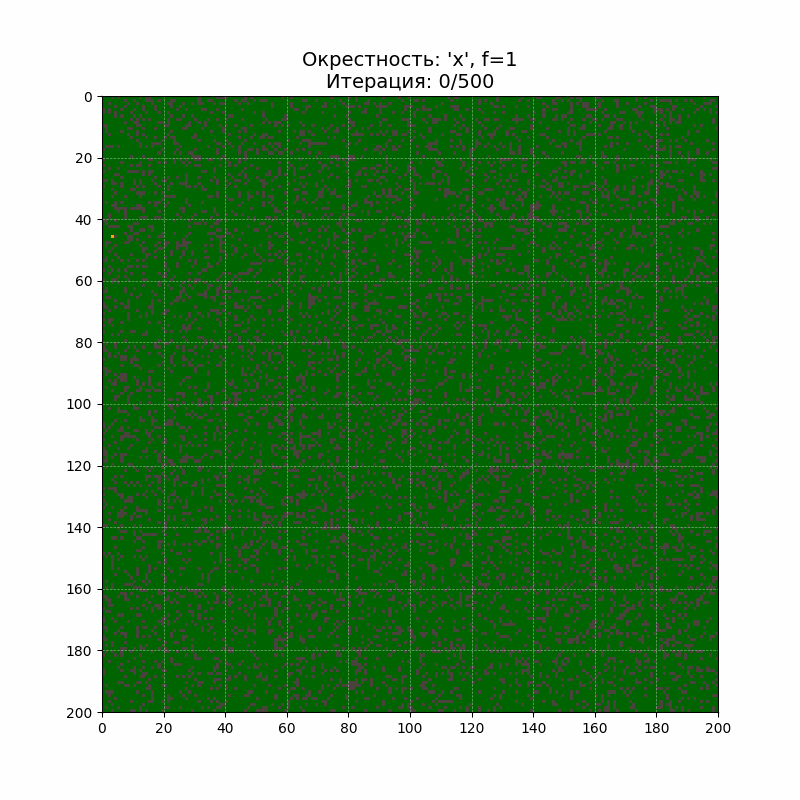

In [ ]:
# GIF Э 2
create_simulation_gif(result_f1_moore, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [11]:
# ЭКСПЕРИМЕНТ 3
F_VALUE = 3
NEIGHBORHOOD = fm.NeighborhoodType.NEUMAN

print(f"Симулируем при f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

result_f3_neuman = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Симулируем при f=3, окрестность='+'...
Готово за 59.20 с.


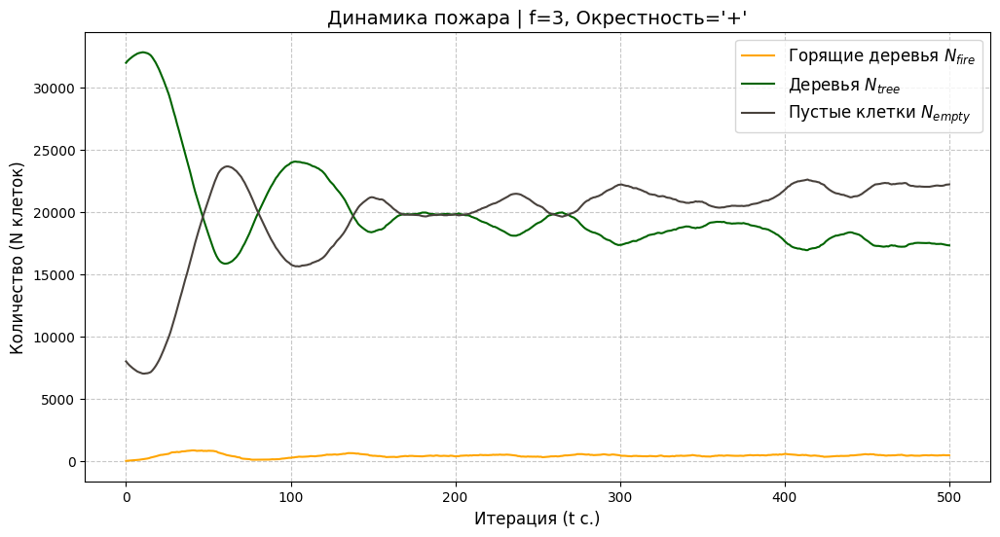

In [ ]:
# ГРАФИК Э 3
draw_simulation_graph(result_f3_neuman, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f3_hoodNEUMAN.gif...
Анимация сохранена: forest_fire_f3_hoodNEUMAN.gif


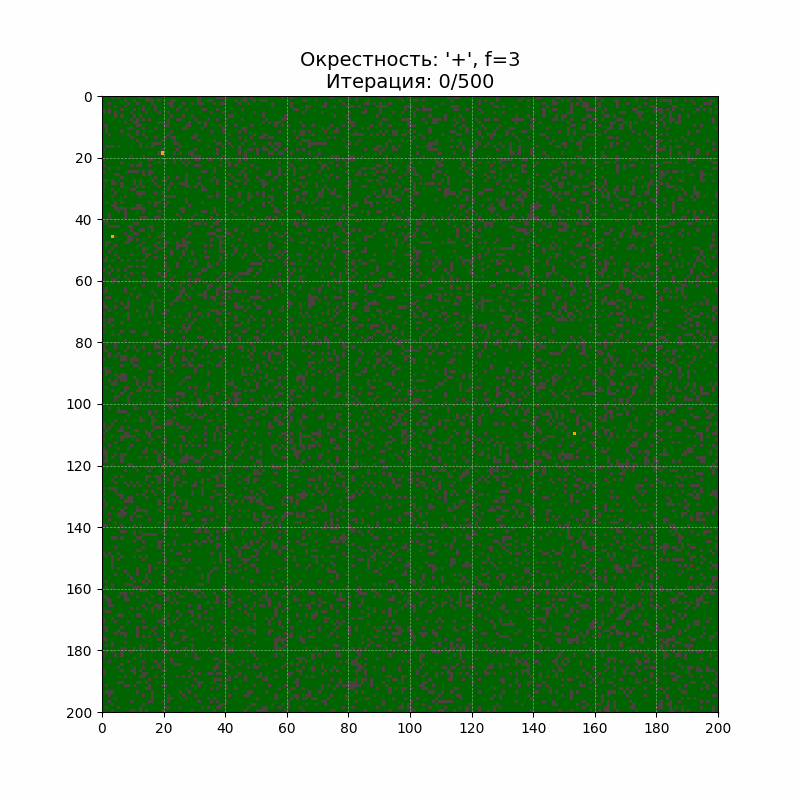

In [ ]:
# GIF Э 3
create_simulation_gif(result_f3_neuman, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [12]:
# ЭКСПЕРИМЕНТ 4
F_VALUE = 3
NEIGHBORHOOD = fm.NeighborhoodType.MOORE

print(f"Запускаем симуляцию: f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

# Сохраняем в НОВУЮ переменную
result_f3_moore = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Запускаем симуляцию: f=3, окрестность='x'...
Готово за 64.76 с.


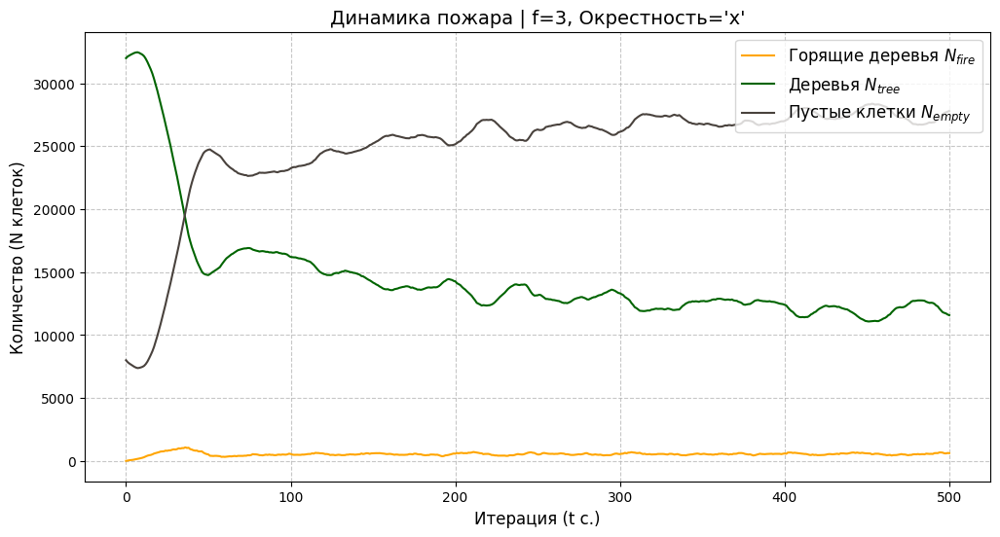

In [ ]:
# ГРАФИК Э 4
draw_simulation_graph(result_f3_moore, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f3_hoodMOORE.gif...
Анимация сохранена: forest_fire_f3_hoodMOORE.gif


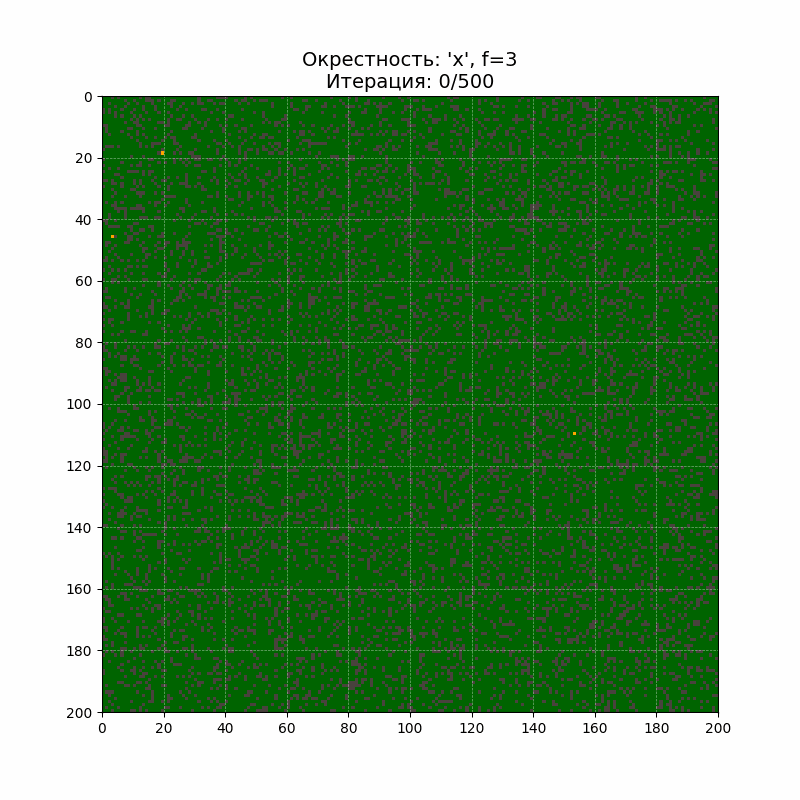

In [ ]:
# GIF Э 4
create_simulation_gif(result_f3_moore, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [13]:
# ЭКСПЕРИМЕНТ 5
F_VALUE = 9
NEIGHBORHOOD = fm.NeighborhoodType.NEUMAN

print(f"Симулируем при f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

result_f9_neuman = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Симулируем при f=9, окрестность='+'...
Готово за 57.57 с.


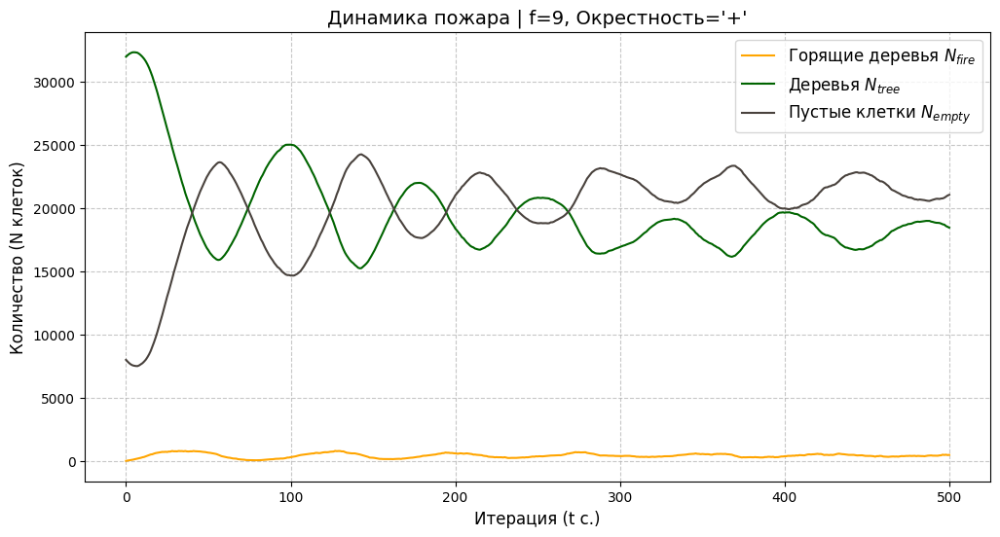

In [ ]:
# ГРАФИК Э 5
draw_simulation_graph(result_f9_neuman, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f9_hoodNEUMAN.gif...
Анимация сохранена: forest_fire_f9_hoodNEUMAN.gif


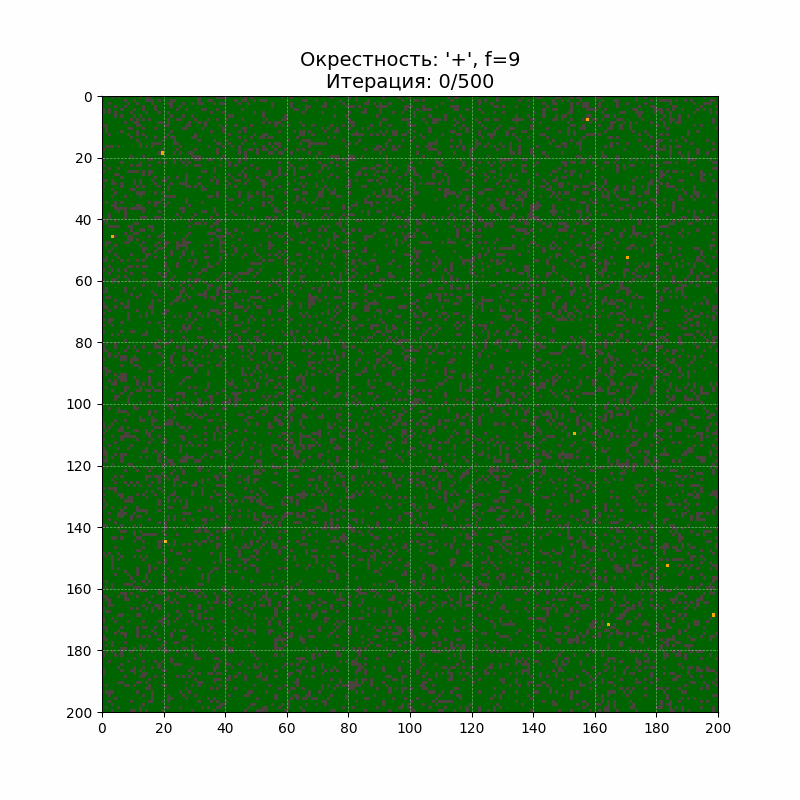

In [ ]:
# GIF Э 5
create_simulation_gif(result_f9_neuman, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [14]:
# ЭКСПЕРИМЕНТ 6
F_VALUE = 9
NEIGHBORHOOD = fm.NeighborhoodType.MOORE

print(f"Запускаем симуляцию: f={F_VALUE}, окрестность='{NEIGHBORHOOD.value}'...")
start_time = time.time()

# Сохраняем в НОВУЮ переменную
result_f9_moore = fm.run_simulation(
    w=w, h=h, eta=eta, Pf=Pf, Pg=Pg,
    f=F_VALUE,
    num_iterations=num_iterations,
    neighborhood_type=NEIGHBORHOOD,
    seed=seed
)

end_time = time.time()
print(f"Готово за {end_time - start_time:.2f} с.")

Запускаем симуляцию: f=9, окрестность='x'...
Готово за 65.28 с.


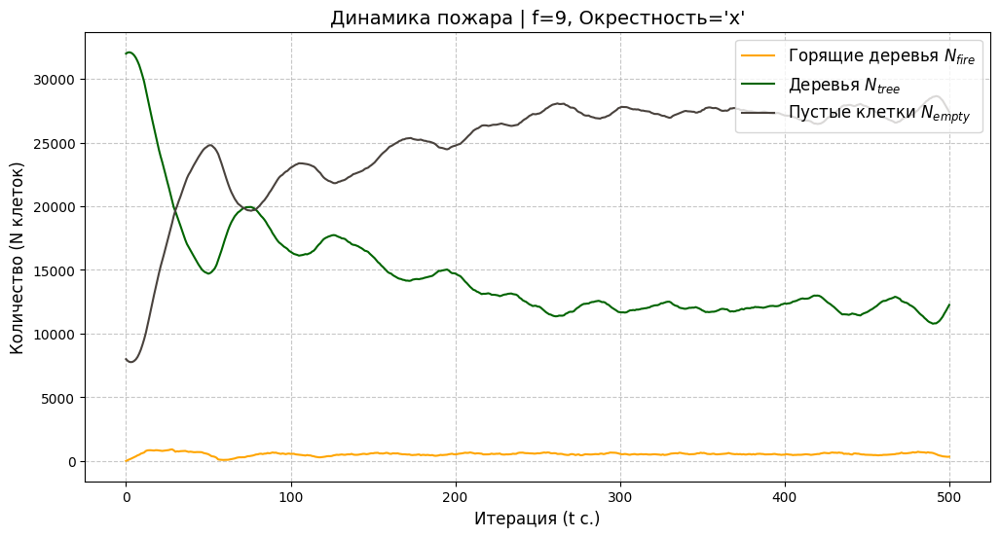

In [ ]:
# ГРАФИК Э 6
draw_simulation_graph(result_f9_moore, F_VALUE, NEIGHBORHOOD, cmap)

Генерируем GIF forest_fire_f9_hoodMOORE.gif...
Анимация сохранена: forest_fire_f9_hoodMOORE.gif


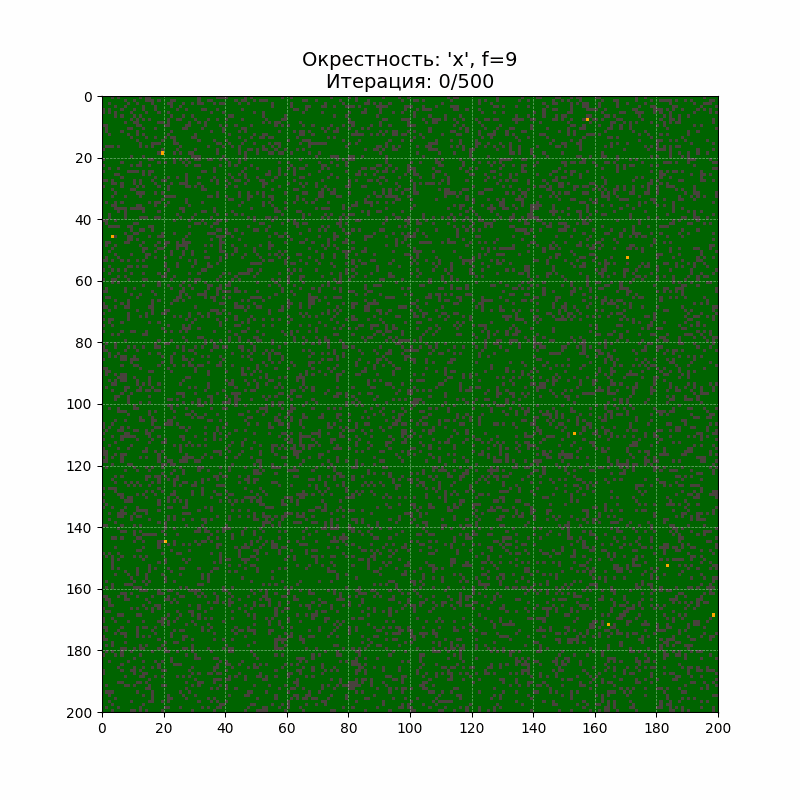

In [ ]:
# GIF Э 6
create_simulation_gif(result_f9_moore, F_VALUE, NEIGHBORHOOD, cmap, w, h, num_iterations)

In [ ]:
def calculate_and_print_stats(result_data, f_value, neighborhood, w, h, eta):
    print("="*60)
    print(f"СТАТИСТИКА ДЛЯ: f={f_value}, Окрестность='{neighborhood.value}'")
    print("="*60)

    stats_fire = np.array(result_data['stats']['fire'])
    stats_tree = np.array(result_data['stats']['tree'])
    stats_empty = np.array(result_data['stats']['empty'])

    initial_trees = stats_tree[0]

    # Категория Пожарные
    print("\n--- Тактический анализ ---")
    peak_intensity = np.max(stats_fire)
    time_to_peak = np.argmax(stats_fire)

    damage_threshold = initial_trees * 0.10
    destroyed_trees_over_time = stats_empty - stats_empty[0]
    # первый момент времени (индекс) когда порог превысился
    serious_damage_indices = np.where(destroyed_trees_over_time >= damage_threshold)[0]
    time_to_10_percent_damage = serious_damage_indices[0] if len(serious_damage_indices) > 0 else "Не достигнуто"

    active_phase_duration = np.sum(stats_fire > (initial_trees * 0.01))
    peak_spread_rate = np.max(np.diff(stats_fire)) if len(stats_fire) > 1 else 0

    print(f"1. Время до 10% ущерба:             {time_to_10_percent_damage} итераций")
    print(f"2. Максимальная интенсивность пожара: {peak_intensity} деревьев")
    print(f"3. Время до пика интенсивности:       {time_to_peak} итераций")
    print(f"4. Длительность активной фазы (>1%): {active_phase_duration} итераций")
    print(f"5. Пиковая скорость распространения:   {peak_spread_rate} новых возгораний/итерацию")

    # Категория Экологи
    print("\n--- Анализ последствий ---")
    total_damage = (stats_empty[-1] - stats_empty[0]) / initial_trees if initial_trees > 0 else 0
    survival_rate = stats_tree[-1] / initial_trees if initial_trees > 0 else 0

    print(f"6. Общий ущерб (доля выгоревшего): {total_damage:.2%}")
    print(f"7. Коэффициент выживания леса:      {survival_rate:.2%}")

    # Категория Аналитики
    print("\n--- Статистические свойства процесса (по горящим деревьям) ---")
    description = stats.describe(stats_fire)

    std_dev = np.sqrt(description.variance)

    quartiles = np.percentile(stats_fire, [25, 50, 75])

    print(f"8. Среднее (mean):                   {description.mean:.2f}")
    print(f"9. Стандартное отклонение (std):     {std_dev:.2f}")
    print(f"10. Квартили (25%, 50%-медиана, 75%): {quartiles[0]:.0f}, {quartiles[1]:.0f}, {quartiles[2]:.0f}")
    print(f"11. Асимметрия (skewness):           {description.skewness:.4f}")
    print(f"12. Эксцесс (kurtosis):              {description.kurtosis:.4f}")
    print(f"13. Мин / Макс значения:             {description.minmax[0]} / {description.minmax[1]}")
    print("\n")

calculate_and_print_stats(result_f1_neuman, 1, fm.NeighborhoodType.NEUMAN, w, h, eta)
calculate_and_print_stats(result_f1_moore, 1, fm.NeighborhoodType.MOORE, w, h, eta)
calculate_and_print_stats(result_f3_neuman, 3, fm.NeighborhoodType.NEUMAN, w, h, eta)
calculate_and_print_stats(result_f3_moore, 3, fm.NeighborhoodType.MOORE, w, h, eta)
calculate_and_print_stats(result_f9_neuman, 9, fm.NeighborhoodType.NEUMAN, w, h, eta)
calculate_and_print_stats(result_f9_moore, 9, fm.NeighborhoodType.MOORE, w, h, eta)

СТАТИСТИКА ДЛЯ: f=1, Окрестность='+'

--- Тактический анализ ---
1. Время до 10% ущерба:             32 итераций
2. Максимальная интенсивность пожара: 831 деревьев
3. Время до пика интенсивности:       35 итераций
4. Длительность активной фазы (>1%): 381 итераций
5. Пиковая скорость распространения:   62 новых возгораний/итерацию

--- Анализ последствий ---
6. Общий ущерб (доля выгоревшего): 41.70%
7. Коэффициент выживания леса:      57.04%

--- Статистические свойства процесса (по горящим деревьям) ---
8. Среднее (mean):                   419.98
9. Стандартное отклонение (std):     152.40
10. Квартили (25%, 50%-медиана, 75%): 328, 417, 511
11. Асимметрия (skewness):           0.0187
12. Эксцесс (kurtosis):              0.2097
13. Мин / Макс значения:             1 / 831


СТАТИСТИКА ДЛЯ: f=1, Окрестность='x'

--- Тактический анализ ---
1. Время до 10% ущерба:             28 итераций
2. Максимальная интенсивность пожара: 1040 деревьев
3. Время до пика интенсивности:       41 итераций
4

<>:32: SyntaxWarning: invalid escape sequence '\T'
<>:32: SyntaxWarning: invalid escape sequence '\T'
/tmp/ipython-input-3161824643.py:32: SyntaxWarning: invalid escape sequence '\T'
  plt.title(f"Варьируем f (при '$\Theta$' = '{hood_type.value}')", fontsize=14)


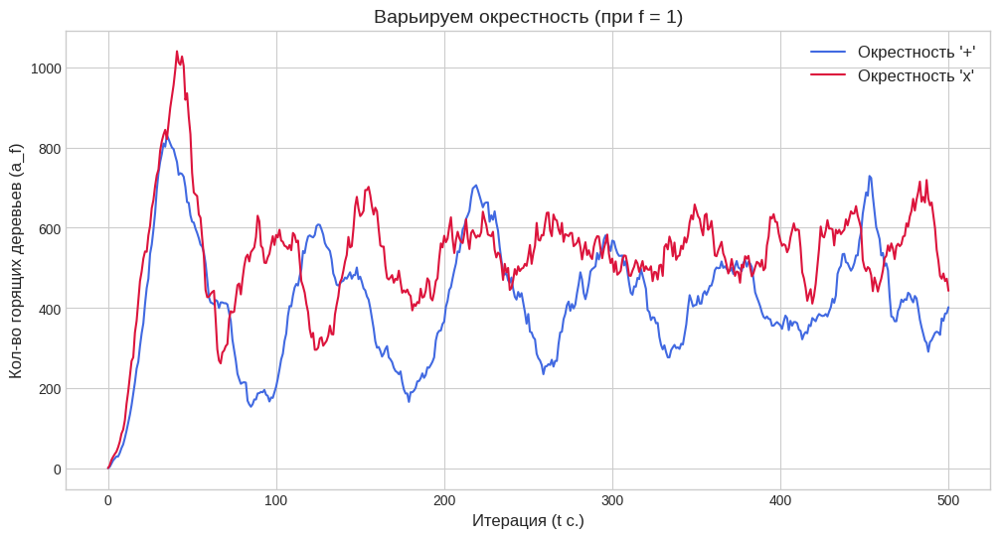

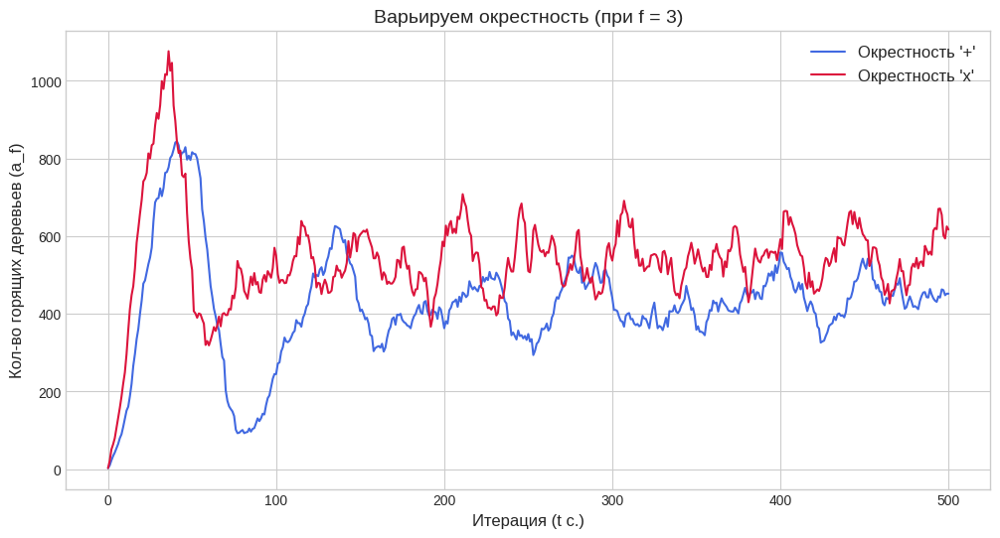

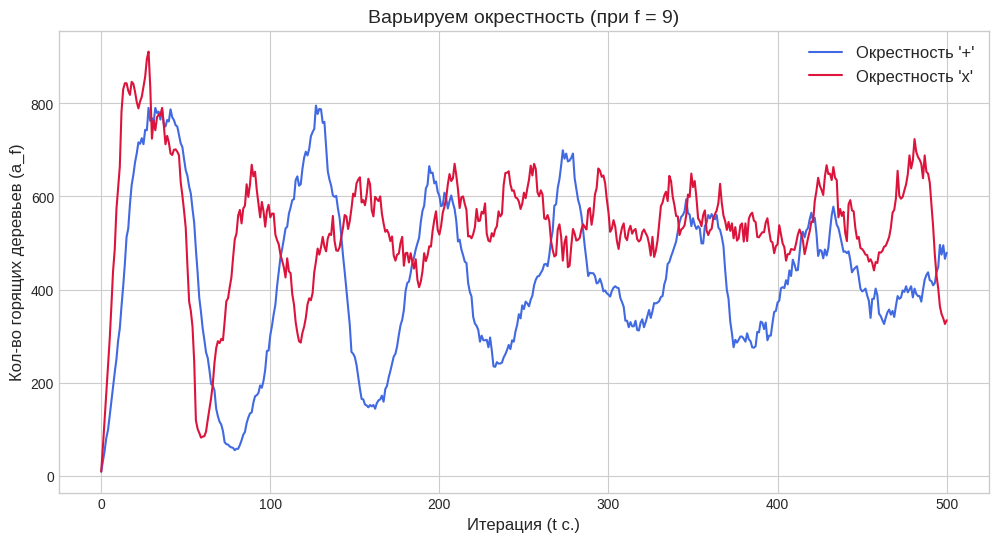

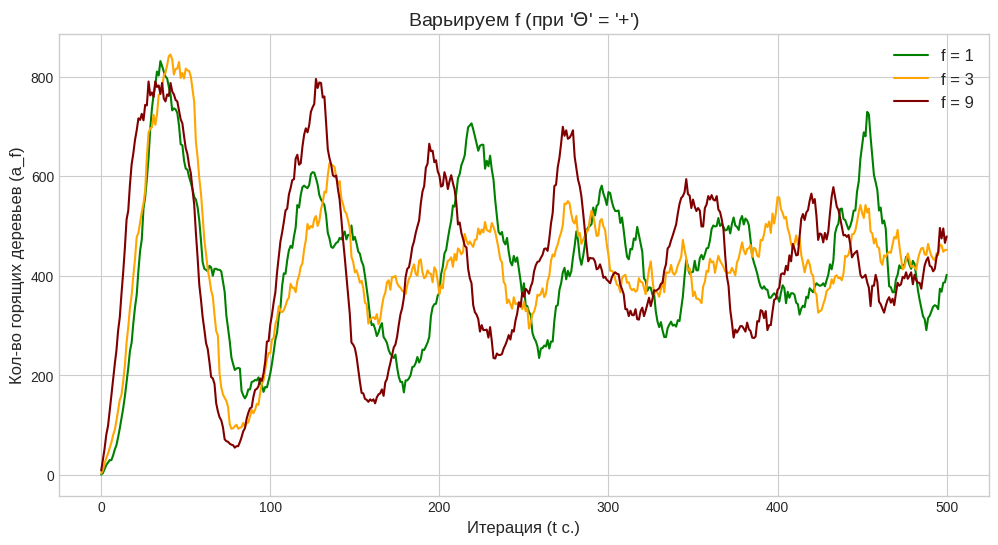

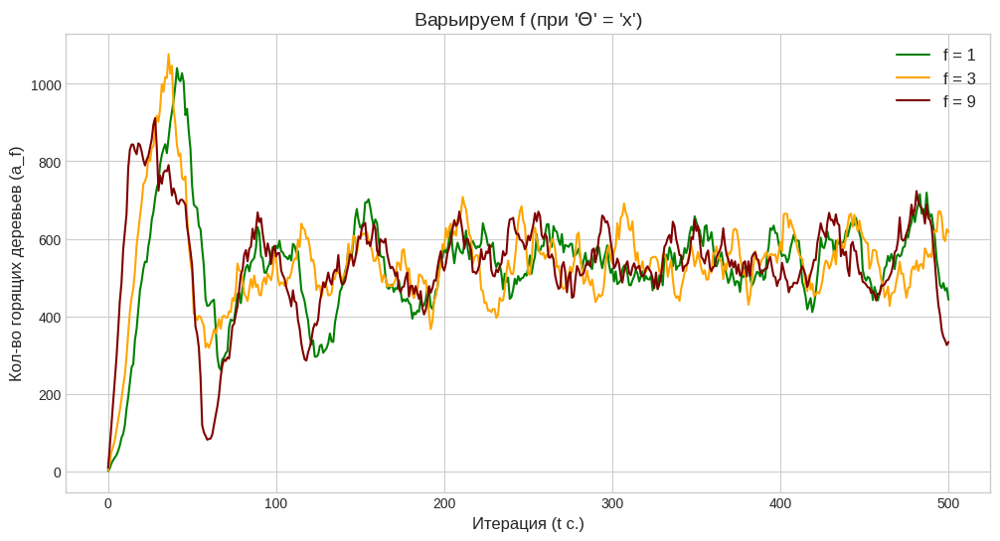

In [23]:
# Сравнительный анализ динамики пожара

all_results = {}
if 'result_f1_neuman' in locals():
    all_results[(1, fm.NeighborhoodType.NEUMAN)] = result_f1_neuman
    all_results[(1, fm.NeighborhoodType.MOORE)] = result_f1_moore
    all_results[(3, fm.NeighborhoodType.NEUMAN)] = result_f3_neuman
    all_results[(3, fm.NeighborhoodType.MOORE)] = result_f3_moore
    all_results[(9, fm.NeighborhoodType.NEUMAN)] = result_f9_neuman
    all_results[(9, fm.NeighborhoodType.MOORE)] = result_f9_moore


    # Влияние типа окрестности
    for f_val in [1, 3, 9]:
        plt.figure(figsize=(12, 6))
        plt.title(f"Варьируем окрестность (при f = {f_val})", fontsize=14)

        data_neuman = all_results[(f_val, fm.NeighborhoodType.NEUMAN)]['stats']['fire']
        plt.plot(data_neuman, label=f"Окрестность '+'", color='royalblue')

        data_moore = all_results[(f_val, fm.NeighborhoodType.MOORE)]['stats']['fire']
        plt.plot(data_moore, label=f"Окрестность 'x'", color='crimson')

        plt.xlabel("Итерация (t с.)", fontsize=12)
        plt.ylabel("Кол-во горящих деревьев (a_f)", fontsize=12)
        plt.legend(fontsize=12)
        plt.show()

    # Влияние числа очагов
    for hood_type in [fm.NeighborhoodType.NEUMAN, fm.NeighborhoodType.MOORE]:
        plt.figure(figsize=(12, 6))
        plt.title(f"Варьируем f (при '$\Theta$' = '{hood_type.value}')", fontsize=14)

        colors = ['green', 'orange', 'maroon']
        for i, f_val in enumerate([1, 3, 9]):
            data = all_results[(f_val, hood_type)]['stats']['fire']
            plt.plot(data, label=f"f = {f_val}", color=colors[i])

        plt.xlabel("Итерация (t с.)", fontsize=12)
        plt.ylabel("Кол-во горящих деревьев (a_f)", fontsize=12)
        plt.legend(fontsize=12)
        plt.show()